In [1]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import skimage.io
from skimage.transform import resize
from imgaug import augmenters as iaa
from tqdm import tqdm
import PIL
from PIL import Image, ImageOps
import cv2

WORKERS = 2
CHANNEL = 3

import warnings
warnings.filterwarnings("ignore")
IMG_SIZE = 512
NUM_CLASSES = 5
SEED = 77
TRAIN_NUM = 1000 # use 1000 when you just want to explore new idea, use -1 for full train


DATA_PATH = "data"

In [2]:
import os
print(os.listdir("data"))

['results_df_20190710232755.pkl', 'results_test_df_20190710232755.pkl', 'processed_train_images', 'results_df_20190711090031.pkl', 'train.csv', 'results_df.pkl', 'train_images', 'test.csv', 'test_images', 'results_test_df_20190711090031.pkl', 'processed_test_images', 'results_test_df.pkl', 'sample_submission.csv']


# 1. Introduction. Explore first, train later.

Hi everyone! As *Aravind Eye Hospital* is one of my favorite organization in the world; they take care of poor people's eyes for free with an impressive sustainable business model.  I will try my best to contribute something to our community. One intuitive way to improve the performance of our model is to simply improve the quality of input images. In this kernel, I will share two ideas which I hope may be useful to some of you : 

- **Decolorize images** : here as we will see, images come with many different lighting conditions, some images are quite dark and difficult to visualize. We can try to convert the image to gray scale, and visualize better. Alternatively, we can try the method of [Ben Graham (last competition's winner)](https://github.com/btgraham/SparseConvNet/tree/kaggle_Diabetic_Retinopathy_competition)
- **Cropping uninformative area** : everyone know this :) Here, I just find the codes from internet and choose the best one for you :)

We are going to apply both techniques to both the official data, and the past competition data (shout out @tanlikesmath for creating this dataset! https://www.kaggle.com/tanlikesmath/diabetic-retinopathy-resized . In the updated version, I also try @donkeys' dataset https://www.kaggle.com/donkeys/retinopathy-train-2015 , which is .png which may be have higer image quality than .jpeg format)

If I found more useful tricks, I will update the notebook, or if you have more useful tricks and would love to share, please let me know!

I use some parts of codes from @mathormad and @artgor kernels. Thanks both of you!

Now let us start by loading the train/test dataframes. The `train_test_split` here is in fact not necessary. But when I first fork the kernel from @mathormad, I found some interesting examples using this split and the current `SEED`, so I continue to use them here.

In [3]:
df_train = pd.read_csv(DATA_PATH + '/train.csv')

x = df_train['id_code']
y = df_train['diagnosis']


(3662,) (3662,)


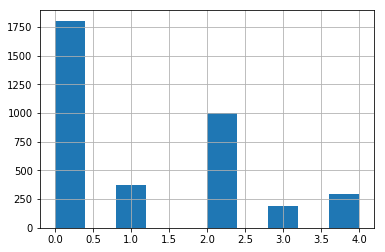

In [4]:
print(x.shape, y.shape)
y.hist()

## 1.1 Simple picture to explain Diabetic Retinopathy

How do we know that a patient have diabetic retinopahy? There are 5 things to spot on. Image credit https://www.eyeops.com/
![credit : https://www.eyeops.com/](https://sa1s3optim.patientpop.com/assets/images/provider/photos/1947516.jpeg)

From quick investigations of the data (see various pictures below), I found that *Hemorrphages, Hard Exudates and Cotton Wool spots* are quite easily observed. However, I still could not find examples of *Aneurysm* or *Abnormal Growth of Blood Vessels* from our data yet. Perhaps the latter two cases are important if we want to catch up human benchmnark using our model.

## 1.2 Original Inputs

First, let have a glance of original inputs. Each row depicts each severity level. We can see two problems which make the severity difficult to spot on. First, some images are very dark [pic(0,2) and pic(4,4) ] and sometimes different color illumination is confusing [pic (3,3)]. Second, we can get the uninformative dark areas for some pictures [pic(0,1), pic(0,3)]. This is important when we reduce the picture size, as informative areas become too small. So it is intuitive to crop the uninformative areas out in the second case.

In [6]:
# Choose 5 random images one for each different diagnosis value

image_list = []
for class_id in sorted(y.unique()):
    image_list.append(df_train.loc[df_train['diagnosis'] == class_id].sample(1, random_state=SEED))

image_list

[           id_code  diagnosis
 1361  5ead17e894ae          0,            id_code  diagnosis
 3305  e580676516b0          1,           id_code  diagnosis
 520  2532613a584a          2,            id_code  diagnosis
 2200  9a94e0316ee3          3,          id_code  diagnosis
 88  07122e268a1d          4]

CPU times: user 3.88 s, sys: 49.2 ms, total: 3.93 s
Wall time: 1.01 s


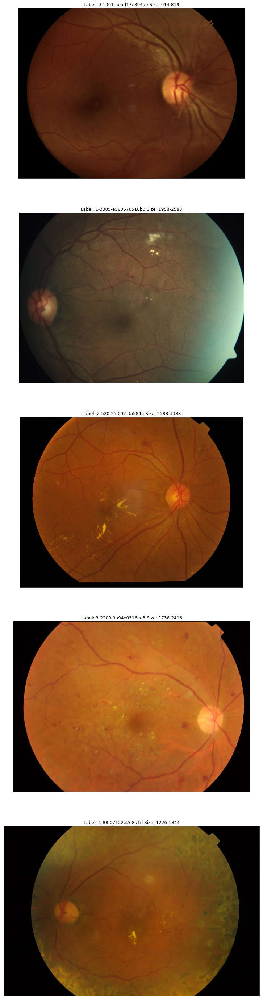

In [7]:
%%time

# those are the original images

fig = plt.figure(figsize=(50, 50))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)
    ax.set_title('Label: %d-%s-%s Size: %d-%d' % (class_id, image_data.index[0] , \
                                                  image_data.iloc[0][0], image.shape[0], image.shape[1]) )
        


We can try gray scale and feel understand better for some pictures, as color distraction is gone. For example, we can see more blood clearer in the upper part of pic(4,4), which has severity of level 4.

CPU times: user 2.59 s, sys: 24.2 ms, total: 2.61 s
Wall time: 538 ms


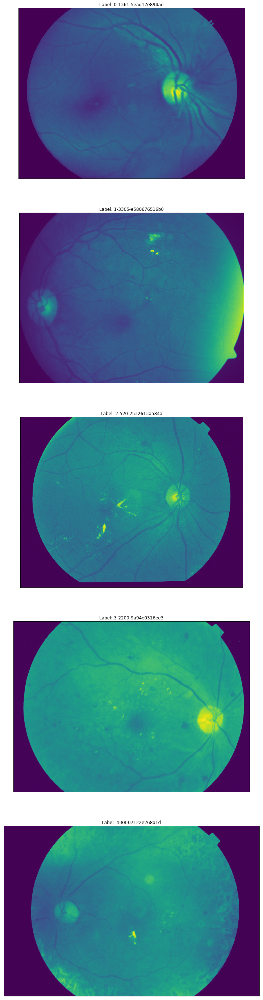

In [8]:
%%time
fig = plt.figure(figsize=(50, 50))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # supressing cmap, images are in blue-yellow and really contrasted
    plt.imshow(image)
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )
        

For severity level 4, I feel that two examples here are difficult to spot on, pic(4,1) and pic(4,4). As we try zooming to see the details (use real size image), we can see some abnormalities (*cotton wool spots* or *hard exudates* ?) in those eyes clearer (observe the lower-right part of the eye). Therefore, `IMG_SIZE` is definitely important for this problem.

2136 3216


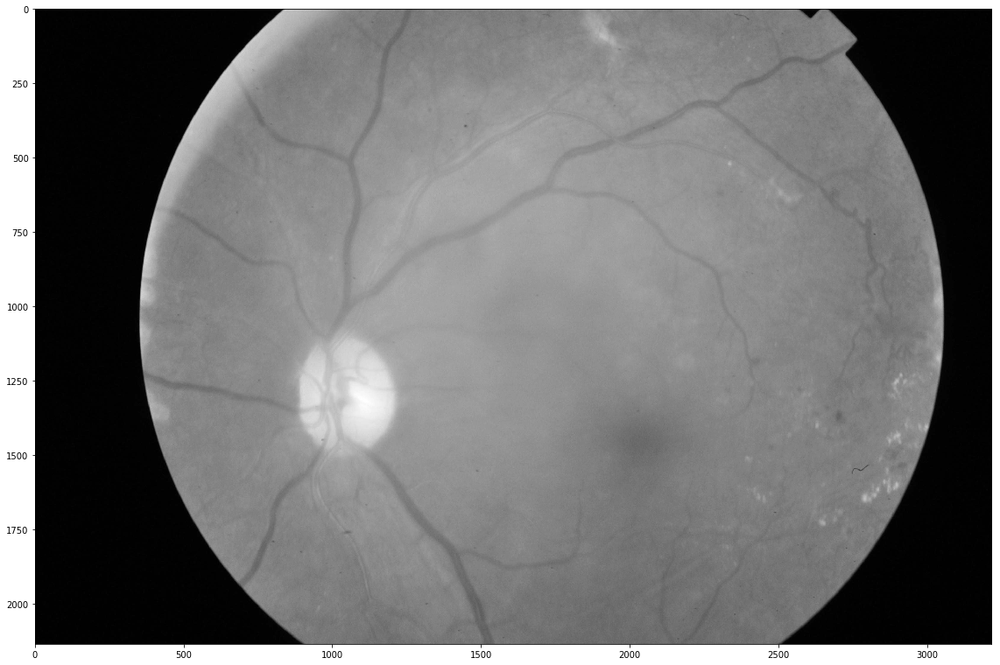

In [9]:
dpi = 80 #inch

# path=f"../input/aptos2019-blindness-detection/train_images/5c7ab966a3ee.png" # notice upper part
path=f"{DATA_PATH}/train_images/cd54d022e37d.png" # lower-right, this still looks not so severe, can be class3
image = cv2.imread(path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
height, width = image.shape
print(height, width)

SCALE=2
figsize = (width / float(dpi))/SCALE, (height / float(dpi))/SCALE

fig = plt.figure(figsize=figsize)
plt.imshow(image, cmap='gray')

# 2. Try Ben Graham's preprocessing method.

In the last competition, [Ben Graham (last competition's winner)](https://github.com/btgraham/SparseConvNet/tree/kaggle_Diabetic_Retinopathy_competition) share insightful way to improve lighting condition. Here, we apply his idea, and can see many important details in the eyes much better. For full details, please refer to his technical report in the link above.

CPU times: user 19.1 s, sys: 15.8 ms, total: 19.1 s
Wall time: 2.25 s


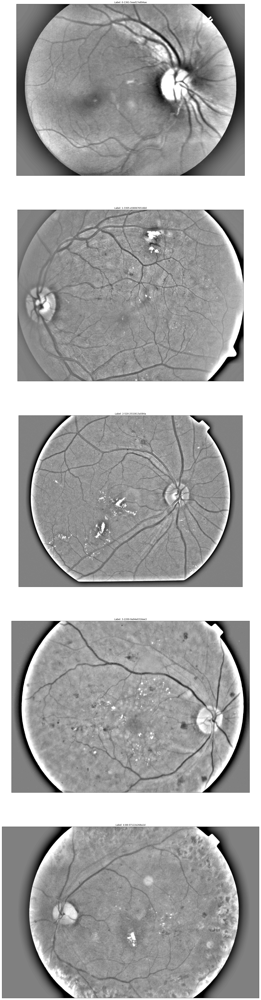

In [10]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # this line is the Ben Graham's preprocessing
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128) 
    # supressing cmap, images are in blue-yellow and really contrasted
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


CPU times: user 19 s, sys: 31.1 ms, total: 19.1 s
Wall time: 2.23 s


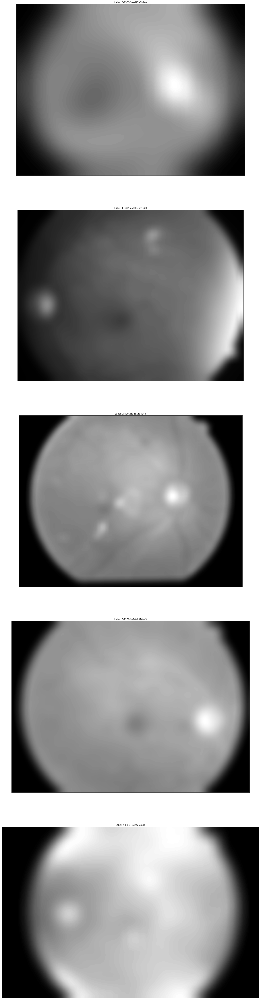

In [11]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # this line is the Ben Graham's preprocessing
    # first obtain blurred image then adds wheigthed
    image = cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10)
    # image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128) 
    # supressing cmap, images are in blue-yellow and really contrasted
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


# 3. Try Histogram Equalization preprocessing method.

Details in https://www.researchgate.net/publication/224014530_A_Comparative_Evaluation_of_Preprocessing_Methods_for_Automatic_Detection_of_Retinal_Anatomy



CPU times: user 2.39 s, sys: 0 ns, total: 2.39 s
Wall time: 477 ms


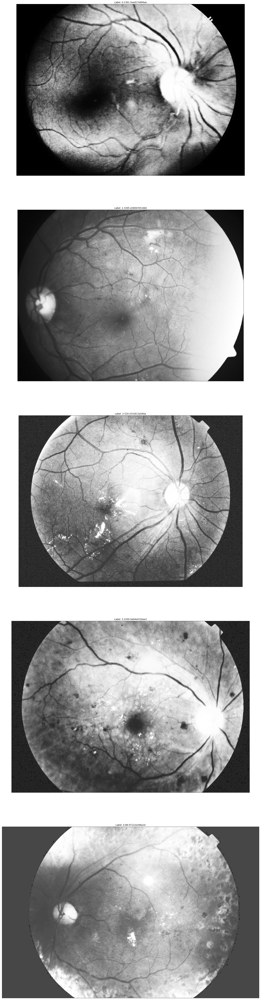

In [12]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # with histogram equalization
    # first obtain image histogram
    # hist, bins = np.histogram(image.flatten(),256, [0,256])
    # cdf = hist.cumsum()
    # cdf_normalyzed = cdf* hist.max()/cdf.max()
    image = cv2.equalizeHist(image)
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


# 4. Try Adaptative Histogram Equalization preprocessing method.

Details pending



CPU times: user 2.87 s, sys: 31.8 ms, total: 2.9 s
Wall time: 544 ms


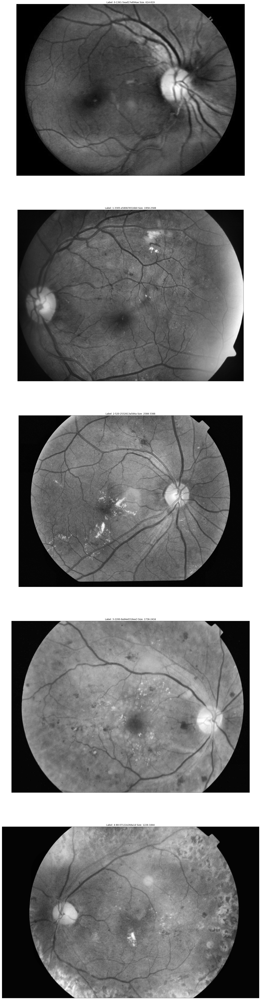

In [13]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # with adaptative histogram normalization
    # first obtain image histogram
    # hist, bins = np.histogram(image.flatten(),256, [0,256])
    # cdf = hist.cumsum()
    # cdf_normalyzed = cdf* hist.max()/cdf.max()
    
    # image = cv2.equalizeHist(image)
    
    # create a CLAHE object (Arguments are optional).
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(6,6))
    image = clahe.apply(image)
    
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s Size: %d-%d' % (class_id, image_data.index[0] , \
                                                  image_data.iloc[0][0], image.shape[0], image.shape[1]) )


# 5. Further improve by auto-cropping

To crop out the uninformative black areas which are evident on pic(0,1), pic(0,3) and pic(4,1), we can try auto cropping. Here I found the following 4 alternative codes from https://stackoverflow.com/questions/13538748/crop-black-edges-with-opencv and https://codereview.stackexchange.com/questions/132914/crop-black-border-of-image-using-numpy/132934 ... Fortunately one method is work perfectly for us (gray-scale only). If anybody can fix a code to also auto-crop the image color, I would be appreciate :)


In [14]:
def crop_image1(img,tol=8):
    # img is image data
    # tol  is tolerance
        
    mask = img>tol
    return img[np.ix_(mask.any(1),mask.any(0))]


In [15]:
'''all of these do not work'''

def crop_image2(image,threshold=5):
    if len(image.shape) == 3:
        flatImage = np.max(image, 2)
    else:
        flatImage = image
    assert len(flatImage.shape) == 2

    rows = np.where(np.max(flatImage, 0) > threshold)[0]
    if rows.size:
        cols = np.where(np.max(flatImage, 1) > threshold)[0]
        image = image[cols[0]: cols[-1] + 1, rows[0]: rows[-1] + 1]
    else:
        image = image[:1, :1]

    return image

def crop_image3(image):
    mask = image > 0

    # Coordinates of non-black pixels.
    coords = np.argwhere(mask)

    # Bounding box of non-black pixels.
    x0, y0 = coords.min(axis=0)
    x1, y1 = coords.max(axis=0) + 1   # slices are exclusive at the top
    
    # Get the contents of the bounding box.
    cropped = image[x0:x1, y0:y1]
    return cropped

def crop_image4(image):
    _,thresh = cv2.threshold(image,1,255,cv2.THRESH_BINARY)
    contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    cnt = contours[0]
    x,y,w,h = cv2.boundingRect(cnt)
    crop = image[y:y+h,x:x+w]
    return crop



### Try Cropping the images

I have tested on around 200 images, and the method works great. However, if anybody find the outlier cases which cause the auto crop to fail, please let me know. I think now the eye pictures are very like the moon by the way :)

In [38]:
def enhance(image, clip_limit=3):
      
    # convert image to LAB color model
    image_lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)

    # split the image into L, A, and B channels
    l_channel, a_channel, b_channel = cv2.split(image_lab)

    # apply CLAHE to lightness channel
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=(8, 8))
    cl = clahe.apply(l_channel)

    # merge the CLAHE enhanced L channel with the original A and B channel
    merged_channels = cv2.merge((cl, a_channel, b_channel))

    # convert iamge from LAB color model back to RGB color model
    final_image = cv2.cvtColor(merged_channels, cv2.COLOR_LAB2BGR)
    final_image = cv2.cvtColor(final_image, cv2.COLOR_BGR2GRAY)
    return final_image

In [39]:
def deviation_from_mean(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    clahe_output = clahe.apply(image)
    print(clahe_output)
    result = clahe_output.copy()
    result = result.astype('int')
    i = 0
    j = 0
    while i < image.shape[0]:
        j = 0
        while j < image.shape[1]:
            sub_image = clahe_output[i:i+5,j:j+5]
            mean = np.mean(sub_image)
            sub_image = sub_image - mean
            result[i:i+5,j:j+5] = sub_image
            j = j+5
        i = i+5
    return result

In [40]:
def normalized_histogram(img):
    hist,bins = np.histogram(img.flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / hist.min()
    return cdf_normalized
    


CPU times: user 3.39 s, sys: 36 ms, total: 3.43 s
Wall time: 604 ms


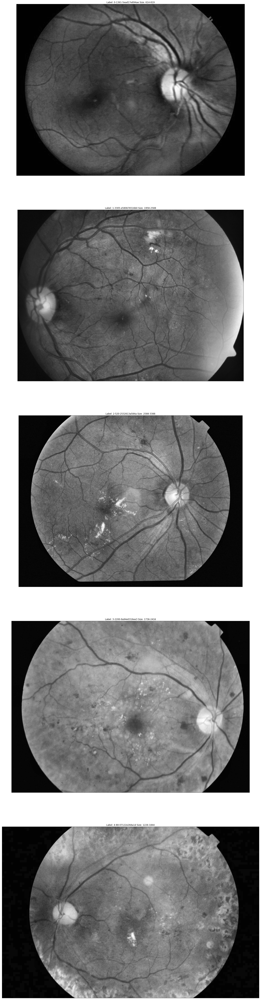

In [44]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    #plt.plot(normalized_histogram(image), color='b')
    #plt.hist(image.flatten(),256,[0,256], color = 'r')
    #plt.xlim([0,256])
    #plt.legend(('cdf','histogram'), loc = 'upper left')
    #plt.show()
    enhanced_image = enhance(image,2)
    #plt.plot(normalized_histogram(enhanced_image), color='b')
    #plt.hist(enhanced_image.flatten(),256,[0,256], color = 'r')
    #plt.xlim([0,256])
    #plt.legend(('cdf','histogram'), loc = 'upper left')
    #plt.show()
    plt.imshow(enhanced_image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s Size: %d-%d' % (class_id, image_data.index[0] , \
                                                  image_data.iloc[0][0], image.shape[0], image.shape[1]) )

## And as last, filtering, cropping and resizing to a 500x500 size....

In [ ]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # with adaptative histogram normalization
    # first obtain image histogram
    # hist, bins = np.histogram(image.flatten(),256, [0,256])
    # cdf = hist.cumsum()
    # cdf_normalyzed = cdf* hist.max()/cdf.max()
    
    # image = cv2.equalizeHist(image)
    
    # create a CLAHE object (Arguments are optional).
    image = crop_image1(image)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(6,6))
    image = clahe.apply(image)
    image = cv2.resize(image, (500,400))
    
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s Size: %d-%d' % (class_id, image_data.index[0] , \
                                                  image_data.iloc[0][0], image.shape[0], image.shape[1]) )

# 6. Prepare the dataset
Create a dataset with cropping and Adaptative Histogram Equalization to see results in training and testing sets


definir un modelo basado en 
https://github.com/tensorflow/models/blob/master/research/slim/nets/inception_v4.py

y en 
https://arxiv.org/pdf/1602.07261.pdf
otras lecturas

https://towardsdatascience.com/a-simple-guide-to-the-versions-of-the-inception-network-7fc52b863202

https://cv-tricks.com/cnn/understand-resnet-alexnet-vgg-inception/


to work with all images but on disk not in memory

https://github.com/tensorflow/tensorflow/blob/r1.3/tensorflow/examples/how_tos/reading_data/convert_to_records.py

https://www.tensorflow.org/guide/datasets#consuming_numpy_arrays

In [ ]:
# Aquí transcribimos las imágenes a un fichero tipo TFRECORD de tamaño
width = 400
height = 500

size = (width,height)

# y guardo un fichero con el tamaño en el nombre
TFRecord_filename = '/mnt/DATA-SSD/data/images{}_{}.tfrecords'.format(width,height)


### Rewrite al images

In [ ]:

def Process( orig_image_filename , final_image_filename , size=(50,50) ):
    try:
        if os.path.isfile(final_image_filename) == False:
            image = cv2.imread(orig_image_filename)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            # with adaptative histogram normalization
            # first obtain image histogram
            # hist, bins = np.histogram(image.flatten(),256, [0,256])
            # cdf = hist.cumsum()
            # cdf_normalyzed = cdf* hist.max()/cdf.max()

            # image = cv2.equalizeHist(image)

            # create a CLAHE object (Arguments are optional).
            image = crop_image1(image)
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(6,6))
            image = clahe.apply(image)
            image = cv2.resize(image, size)
            cv2.imwrite(final_image_filename, image)
            result = final_image_filename
        else:
            result = "Image alrwady processed"
    except Exception as e:
        result = e
    return result


In [ ]:
%%time

# transforms all train images
num_images = 0
for image_name in df_train.iterrows():
    readpath=f"{DATA_PATH}/train_images/{image_name[1][0]}.png"
    writepath=f"{DATA_PATH}/processed_train_images/{image_name[1][0]}.png"
    result = Process(readpath, writepath, size)
    num_images += 1
    print(result)
    
print('Num images visited:', num_images)

In [ ]:
%%time

# transforms all test images
num_images = 0
for image_name in df_test.iterrows():
    readpath=f"{DATA_PATH}/test_images/{image_name[1][0]}.png"
    writepath=f"{DATA_PATH}/processed_test_images/{image_name[1][0]}.png"
    result = Process(readpath, writepath, size)
    num_images += 1
    print(result)
print('Num Images visted: ', num_images)

## Creates dataset and saves it in a TFRecord

The idea is to feed the model directly with the dataset to avoid memory fill. I'll make slower the training process..

URLS for creating a TFRecord file
http://yeephycho.github.io/2016/08/15/image-data-in-tensorflow/


In [ ]:
# https://stackoverflow.com/questions/46820500/how-to-handle-large-amouts-of-data-in-tensorflow/47040165#47040165
# indica que transforma matrices numpy en TFRecords
# this was the good solution
'''
def array_to_tfrecords(X,y,z):
    feature = {
        'img': tf.train.Feature(float_list=tf.train.FloatList(value=X.flatten())),
        'label': tf.train.Feature(float_list=tf.train.FloatList(value=y.flatten())),
        'name': tf.train.Feature(bytes_list=tf.train.BytesList(value=z))
    }
'''
def array_to_tfrecords(X,y):
    feature = {
        'img': tf.train.Feature(float_list=tf.train.FloatList(value=X.flatten())),
        'label': tf.train.Feature(float_list=tf.train.FloatList(value=y.flatten()))
    }

    example = tf.train.Example(features=tf.train.Features(feature=feature))
    serialized = example.SerializeToString()
    return serialized


In [ ]:
def load_image(image_path):
    try:
        img = cv2.imread(image_path,cv2.IMREAD_GRAYSCALE)
        return img
    except Exception as e:
        print('Some error ocurred, {}'.format(e))
        return False

In [ ]:
# Aquí transcribimos las imágenes a un fichero tipo TFRECORD
count = 0

# y guardo un fichero con el tamaño en el nombre
# imagesXXX_XXX file has three elements in feature definition
# images2XXX_XXX has two elements in feature definition
TFRecord_filename = '/mnt/DATA-SSD/DataSandbox/images2{}_{}.tfrecords'.format(width,height)

if os.path.isfile(TFRecord_filename) == True:
    os.rename(TFRecord_filename, '{}.{}'.format(TFRecord_filename,\
                                                datetime.datetime.now().strftime("%Y%m%d%H%M%S")))

with tf.python_io.TFRecordWriter(TFRecord_filename) as writer:
    # iterate though list of train images
    for image_name in df_train.iterrows():
        count += 1
        # create the label 
        label = np.zeros((NUM_CLASSES))
        label[image_name[1][1]] = 1
        # construct the filename to processed images
        filename=f"{DATA_PATH}/processed_train_images/{image_name[1][0]}.png"
        # here loads and transforms image
        im2 = load_image(filename)
        name = [bytes(image_name[1][0],'utf-8')]
        print('COUNT: {}, Filename: {} with shape {} , Class: {} with shape {}, Name: {} with shape {}'\
              .format(count, filename, im2.shape, image_name[1][1], label.shape, name, len(name)))
        # tf_image = array_to_tfrecords(im2,label,name)
        tf_image = array_to_tfrecords(im2,label)
        writer.write(tf_image)
        

    new_img = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
    plt.imshow(new_img)
    print('Parsed {} images'.format(count))